# **Inteligência Artificial aplicada à Visão Computacional**

**Capítulo 6: Visão Computacional aplicada ao reconhecimento de emoções**



<p align="justify">

Todos os direitos reservados à Facti, 2024
<p>

[www.qualifacti.com.br](https://)

---

<p align="justify">
É importante esclarecer que estas atividades não compõem a avaliação e não haverá correção formal por parte dos instrutores; o objetivo é a autoaprendizagem e prática.
<p>

---

# **Estudo de caso**

## Importando as bibliotecas

In [ ]:
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from google.colab.patches import cv2_imshow
import zipfile

cv2.__version__

'4.8.0'

In [ ]:
%tensorflow_version 2.x
import tensorflow
tensorflow.__version__

Colab only includes TensorFlow 2.x; %tensorflow_version has no effect.


'2.15.0'

## Conectando com o Drive e acessando os arquivos

In [ ]:
# Conectando o Colab ao Google Drive
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
# Realize o dowload da pasta Material_complementar_reconhecimento_emocoes.zip do Google Sala de Aula e transfira-a para o seu Google Drive
# Localize o caminho da pasta no menu Arquivos, no menu lateral esquerdo
path = "/content/gdrive/MyDrive/Material_complementar_reconhecimento_emocoes.zip"
zip_object = zipfile.ZipFile(file=path, mode="r")
zip_object.extractall("./")

In [ ]:
# Indique o caminho da pasta "fer2013.zip" para descompactá-la. São arquivos organizados conforme cada uma das classes de emoções.
base_imgs = '/content/fer2013.zip'
zip_object = zipfile.ZipFile(file = base_imgs, mode = 'r')
zip_object.extractall('./')
zip_object.close

<bound method ZipFile.close of <zipfile.ZipFile filename='/content/fer2013.zip' mode='r'>>

## Acessando a base com fotos de expressões faciais



In [ ]:
# Arquivo que contem as informações do banco de imagens das fotos de cada classe de emoção.
data = pd.read_csv('fer2013/fer2013.csv')
data.tail()

,emotion,pixels,Usage
35882,6,50 36 17 22 23 29 33 39 34 37 37 37 39 43 48 5...,PrivateTest
35883,3,178 174 172 173 181 188 191 194 196 199 200 20...,PrivateTest
35884,0,17 17 16 23 28 22 19 17 25 26 20 24 31 19 27 9...,PrivateTest
35885,3,30 28 28 29 31 30 42 68 79 81 77 67 67 71 63 6...,PrivateTest
35886,2,19 13 14 12 13 16 21 33 50 57 71 84 97 108 122...,PrivateTest


Text(0.5, 1.0, 'Imagens x emoções')

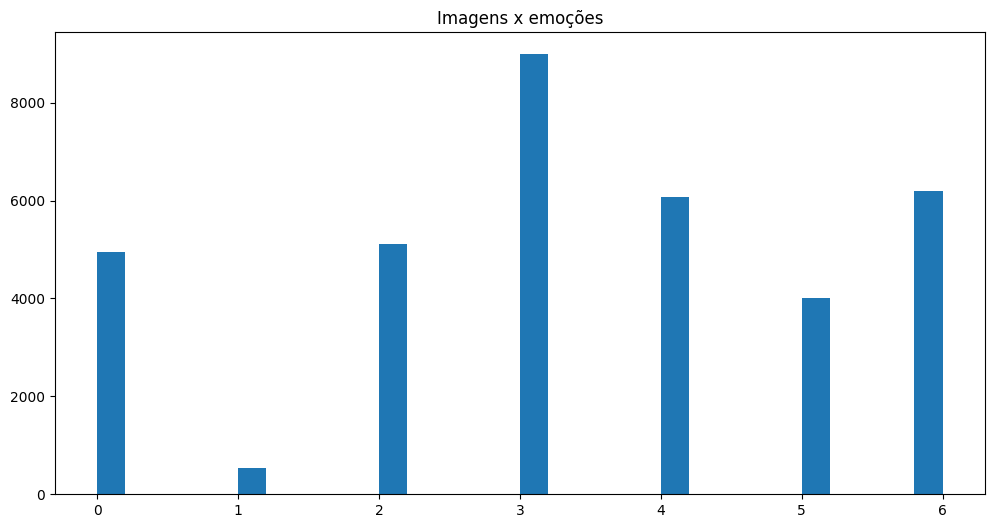

In [ ]:
# Visualizando a quantidade de fotos existente em cada uma das classes de emoções.
plt.figure(figsize=(12,6))
plt.hist(data['emotion'], bins = 30)
plt.title('Imagens x emoções')

# Classes: ['Angry', 'Disgust', 'Fear', 'Happy', 'Sad', 'Surprise', 'Neutral']

## Pré-processamento

In [ ]:
# Listando os valores de pixels das imagens
pixels = data['pixels'].tolist()

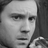

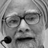

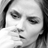

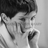

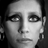

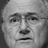

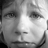

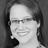

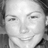

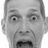

In [ ]:
# Redimensionando as imagens encontradas
largura, altura = 48, 48
faces = []
amostras = 0
for pixel_sequence in pixels:
  face = [int(pixel) for pixel in pixel_sequence.split(' ')]
  face = np.asarray(face).reshape(largura, altura)
  faces.append(face)

  if (amostras < 10): # demonstrando um conjunto de 10 amostras
    cv2_imshow(face)
  amostras += 1

In [ ]:
# Demonstrando a quantidade total de imagens em que foram encontradas faces.
print('Número total de imagens no dataset: ', str(len(faces)))

Número total de imagens no dataset:  35887


In [ ]:
# Convertendo as faces das imagens em arrays
faces = np.asarray(faces)

In [ ]:
# Demonstrando as formas das faces das imagens (quantidade, pixels x, pixels y)
faces.shape

(35887, 48, 48)

In [ ]:
# Expandindo as dimensões das faces das imagens (quantidade, pixels x, pixels y, quantidade de canais)
faces = np.expand_dims(faces, -1)
faces.shape

(35887, 48, 48, 1)

In [ ]:
# Definindo a função para normalizar as imagens
def normalizar(x):
  x = x.astype('float32')
  x = x / 255.0
  return x

In [ ]:
# Normalizando as imagens das faces
faces = normalizar(faces)

In [ ]:
# Atribuindo valores a cada uma das classes de emoções
emocoes = pd.get_dummies(data['emotion']).values

## Imports do Tensorflow/Keras

In [ ]:
from sklearn.model_selection import train_test_split
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, Activation, Flatten
from tensorflow.keras.layers import Conv2D, MaxPooling2D, BatchNormalization
from tensorflow.keras.losses import categorical_crossentropy
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.regularizers import l2
from tensorflow.keras.callbacks import ReduceLROnPlateau, EarlyStopping, ModelCheckpoint
from tensorflow.keras.models import load_model
from tensorflow.keras.models import model_from_json

## Dividir em conjuntos para treinamento e validação

In [ ]:
# Criando os conjuntos de treinamento e validação
X_train, X_test, y_train, y_test = train_test_split(faces, emocoes, test_size = 0.1, random_state = 42)
X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size = 0.1, random_state = 41)

In [ ]:
# Quantidade das imagens dos conjuntos
print('Número de imagens no conjunto de treinamento:', len(X_train))
print('Número de imagens no conjunto de teste:', len(X_test))
print('Número de imagens no conjunto de validação:', len(X_val))

Número de imagens no conjunto de treinamento: 29068
Número de imagens no conjunto de teste: 3589
Número de imagens no conjunto de validação: 3230


In [ ]:
# Base de dados para a matriz de confusão
np.save('mod_xtest', X_test)
np.save('mod_ytest', y_test)

## Arquitetura do modelo da rede neural convolucional (CNN)

**Arquitetura do modelo**

In [ ]:
# Criando o modelo sequencial da rede neural, trazendo cada uma das camadas.
num_features = 64
num_labels = 7
batch_size = 64
epochs = 50
width, height = 48, 48

model = Sequential()

model.add(Conv2D(num_features, kernel_size=(3,3), activation='relu',
                 input_shape=(width, height, 1), data_format = 'channels_last',
                 kernel_regularizer = l2(0.01)))
model.add(Conv2D(num_features, kernel_size=(3,3), activation='relu', padding='same'))
model.add(BatchNormalization())
model.add(MaxPooling2D(pool_size=(2,2), strides=(2,2)))
model.add(Dropout(0.5))

model.add(Conv2D(2*num_features, kernel_size=(3,3), activation='relu', padding='same'))
model.add(BatchNormalization())
model.add(Conv2D(2*num_features, kernel_size=(3,3), activation='relu', padding='same'))
model.add(BatchNormalization())
model.add(MaxPooling2D(pool_size=(2,2), strides=(2,2)))
model.add(Dropout(0.5))

model.add(Conv2D(2*2*num_features, kernel_size=(3,3), activation='relu', padding='same'))
model.add(BatchNormalization())
model.add(Conv2D(2*2*num_features, kernel_size=(3,3), activation='relu', padding='same'))
model.add(BatchNormalization())
model.add(MaxPooling2D(pool_size=(2,2), strides=(2,2)))
model.add(Dropout(0.5))

model.add(Conv2D(2*2*2*num_features, kernel_size=(3,3), activation='relu', padding='same'))
model.add(BatchNormalization())
model.add(Conv2D(2*2*2*num_features, kernel_size=(3,3), activation='relu', padding='same'))
model.add(BatchNormalization())
model.add(MaxPooling2D(pool_size=(2,2), strides=(2,2)))
model.add(Dropout(0.5))

model.add(Flatten())

model.add(Dense(2*2*2*num_features, activation='relu'))
model.add(Dropout(0.4))
model.add(Dense(2*2*num_features, activation='relu'))
model.add(Dropout(0.4))
model.add(Dense(2*num_features, activation='relu'))
model.add(Dropout(0.5))

model.add(Dense(num_labels, activation = 'softmax'))

model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 46, 46, 64)        640       
                                                                 
 conv2d_1 (Conv2D)           (None, 46, 46, 64)        36928     
                                                                 
 batch_normalization (Batch  (None, 46, 46, 64)        256       
 Normalization)                                                  
                                                                 
 max_pooling2d (MaxPooling2  (None, 23, 23, 64)        0         
 D)                                                              
                                                                 
 dropout (Dropout)           (None, 23, 23, 64)        0         
                                                                 
 conv2d_2 (Conv2D)           (None, 23, 23, 128)       7

## Compilando o modelo

In [ ]:
model.compile(loss = 'categorical_crossentropy', # Classificação - cálculo dos erros
              optimizer = Adam(lr = 0.001, beta_1=0.9, beta_2=0.999, epsilon=1e-7), # Atualização dos pesos / taxa decaimento e taxa aprendizagem
              metrics = ['accuracy'])

arquivo_modelo = 'modelo_01_expressoes.h5' # Traz os modelos salvos - com o conjunto dos pesos de aprendizado da rede neural
arquivo_modelo_json = 'modelo_01_expressoes.json' # Traz a estrutura da rede neural

lr_reducer = ReduceLROnPlateau(monitor='val_loss', factor = 0.9, patience=3, verbose = 1)
early_stopper = EarlyStopping(monitor='val_loss', min_delta=0, patience = 8, verbose = 1, mode = 'auto')
checkpointer = ModelCheckpoint(arquivo_modelo, monitor='val_loss', verbose = 1, save_best_only=True)

**Salvando a arquitetura do modelo em um arquivo JSON**

In [ ]:
model_json = model.to_json()
with open(arquivo_modelo_json, 'w') as json_file:
  json_file.write(model_json)

## Treinando o modelo

In [ ]:
history = model.fit(np.array(X_train), np.array(y_train),
                    batch_size = batch_size, #64
                    epochs = epochs, #100
                    verbose = 1,
                    validation_data = (np.array(X_val), np.array(y_val)),
                    shuffle=True,
                    callbacks=[lr_reducer, early_stopper, checkpointer])

Epoch 1/50
455/455 [==============================] - ETA: 0s - loss: 2.0024 - accuracy: 0.2149
Epoch 1: val_loss improved from inf to 1.82769, saving model to modelo_01_expressoes.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


455/455 [==============================] - 40s 60ms/step - loss: 2.0024 - accuracy: 0.2149 - val_loss: 1.8277 - val_accuracy: 0.2594 - lr: 0.0010
Epoch 2/50
454/455 [============================>.] - ETA: 0s - loss: 1.8394 - accuracy: 0.2430
Epoch 2: val_loss improved from 1.82769 to 1.81780, saving model to modelo_01_expressoes.h5
455/455 [==============================] - 26s 56ms/step - loss: 1.8394 - accuracy: 0.2430 - val_loss: 1.8178 - val_accuracy: 0.2594 - lr: 0.0010
Epoch 3/50
454/455 [============================>.] - ETA: 0s - loss: 1.8189 - accuracy: 0.2507
Epoch 3: val_loss improved from 1.81780 to 1.79161, saving model to modelo_01_expressoes.h5
455/455 [==============================] - 26s 56ms/step - loss: 1.8188 - accuracy: 0.2507 - val_loss: 1.7916 - val_accuracy: 0.2594 - lr: 0.0010
Epoch 4/50
454/455 [============================>.] - ETA: 0s - loss: 1.7666 - accuracy: 0.2762
Epoch 4: val_loss did not improve from 1.79161
455/455 [==============================] - 

## Gerando gráfico da melhora em cada etapa do treinamento

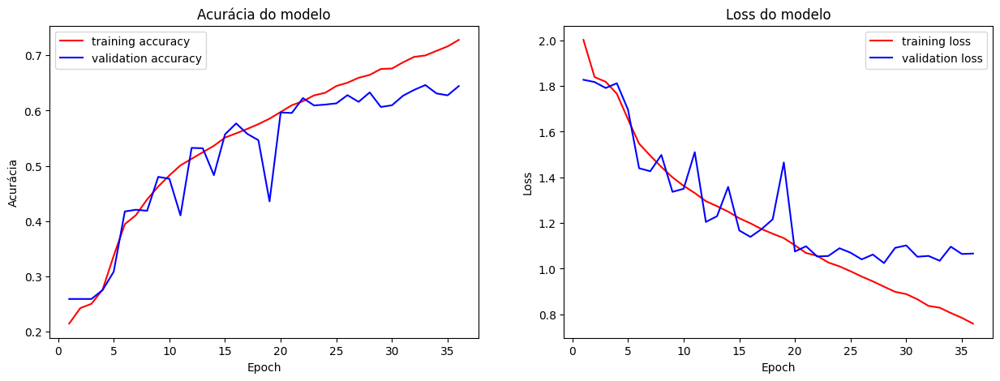

In [ ]:
def plota_historico_modelo(historico_modelo):
  fig, axs = plt.subplots(1, 2, figsize=(15,5))
  axs[0].plot(range(1, len(historico_modelo.history['accuracy']) + 1), historico_modelo.history['accuracy'], 'r')
  axs[0].plot(range(1, len(historico_modelo.history['val_accuracy']) + 1), historico_modelo.history['val_accuracy'], 'b')
  axs[0].set_title('Acurácia do modelo')
  axs[0].set_ylabel('Acurácia')
  axs[0].set_xlabel('Epoch')
  axs[0].legend(['training accuracy', 'validation accuracy'], loc = 'best')
  axs[1].plot(range(1, len(historico_modelo.history['loss']) + 1), historico_modelo.history['loss'], 'r')
  axs[1].plot(range(1, len(historico_modelo.history['val_loss']) + 1), historico_modelo.history['val_loss'], 'b')
  axs[1].set_title('Loss do modelo')
  axs[1].set_ylabel('Loss')
  axs[1].set_xlabel('Epoch')
  axs[1].legend(['training loss', 'validation loss'], loc = 'best')
  fig.savefig('historico_modelo_mod01.png')

plota_historico_modelo(history)

**Verificando a acurácia do modelo**

In [ ]:
# Relação do erro x acurárcia
scores = model.evaluate(np.array(X_test), np.array(y_test), batch_size = batch_size) #
scores

57/57 [==============================] - 1s 21ms/step - loss: 1.1179 - accuracy: 0.6213


In [ ]:
print('Acurácia: ' + str(scores[1]))
print('Erro: ' + str(scores[0]))

Acurácia: 0.6213430166244507
Erro: 1.117859125137329


## Carregamento dos dados para gerar a matriz de confusão

In [ ]:
# Valores reais e das predições
true_y = []
pred_y = []
x = np.load('mod_xtest.npy')
y = np.load('mod_ytest.npy')

In [ ]:
# Carregar o modelo salvo com a estrutura da rede neural
json_file = open(arquivo_modelo_json, 'r')
loaded_model_json = json_file.read()
json_file.close()

In [ ]:
# Transformar o modelo h5
loaded_model = model_from_json(loaded_model_json)
loaded_model.load_weights(arquivo_modelo)

In [ ]:
# Predição dos pixels de cada uma das imagens para cada uma das emoções
y_pred = loaded_model.predict(x)

113/113 [==============================] - 2s 6ms/step


In [ ]:
# Transformar as predições em uma lista
yp = y_pred.tolist()
yt = y.tolist() # com as respostas reais
count = 0

In [ ]:
# Quantidade de registros na base de dados de teste
len(y)

3589

In [ ]:
# Obtendo o maior valor da probabilidade
for i in range(len(y)):
  yy = max(yp[i])
  yyt = max(yt[i])
  pred_y.append(yp[i].index(yy))
  true_y.append(yt[i].index(yyt))
  if (yp[i].index(yy) == yt[i].index(yyt)):
    count += 1

acc = (count / len(y)) * 100

In [ ]:
# Demonstrar o valor da acurácia
print('Acurácia no conjunto de teste: ' + str(acc))

Acurácia no conjunto de teste: 61.4934522151017


In [ ]:
# Salvar os valores das emoções e predições
np.save('truey_mod01', true_y)
np.save('predy_mod01', pred_y)

**Gerando a Matriz de Confusão**

In [ ]:
from sklearn.metrics import confusion_matrix

In [ ]:
y_true = np.load('truey_mod01.npy')
y_pred = np.load('predy_mod01.npy')

In [ ]:
# Matriz de acertos classe por classe
cm = confusion_matrix(y_true, y_pred)
expressoes = ['Raiva', 'Nojo', 'Medo', 'Feliz', 'Triste', 'Surpreso', 'Neutro']
titulo = 'Matriz de Confusão'
print(cm)

[[268   0  52  18  79  13  68]
 [ 32   7   7   1   3   1   1]
 [ 82   2 177  21 143  72  48]
 [ 30   0  15 735  31  17  53]
 [ 73   0  44  23 322   4 122]
 [ 11   0  51  28   9 304  11]
 [ 35   0  26  37 104  15 394]]


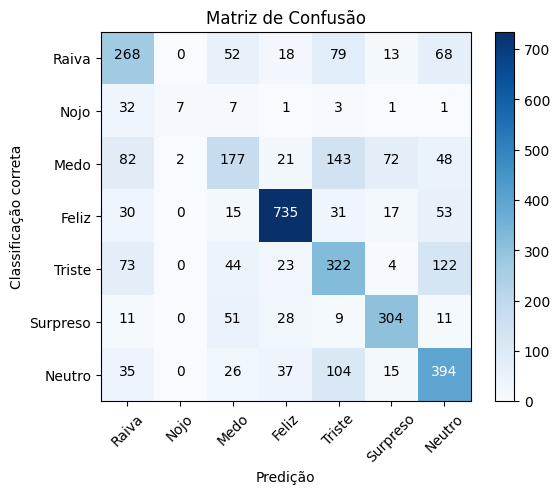

In [ ]:
# Construindo a matriz de confusão
import itertools
plt.imshow(cm, interpolation='nearest', cmap=plt.cm.Blues)
plt.title(titulo)
plt.colorbar()
tick_marks = np.arange(len(expressoes))
plt.xticks(tick_marks, expressoes, rotation = 45)
plt.yticks(tick_marks, expressoes)
fmt = 'd'
thresh = cm.max() / 2.
for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
  plt.text(j, i, format(cm[i, j], fmt), horizontalalignment='center', color='white' if cm[i,j] > thresh else 'black')

plt.ylabel('Classificação correta')
plt.xlabel('Predição')
plt.savefig('matriz_confusao_mod01.png')

## Testando o modelo

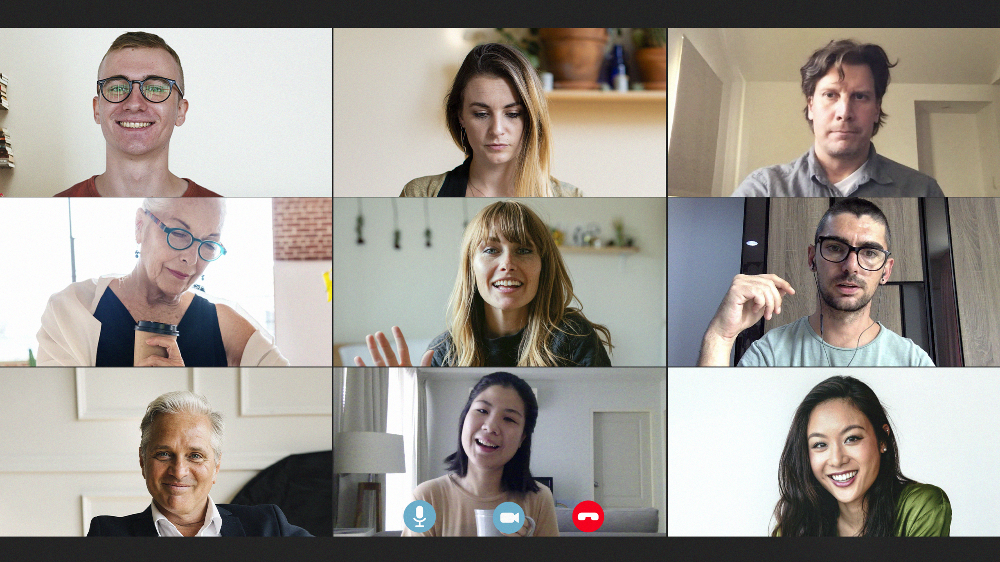

In [ ]:
# Localize o arquivo "salagooglemeet.jpg" para realizar o reconhecimento das emoções
imagem = cv2.imread('/content/testes/salagooglemeet.jpg')
cv2_imshow(imagem)

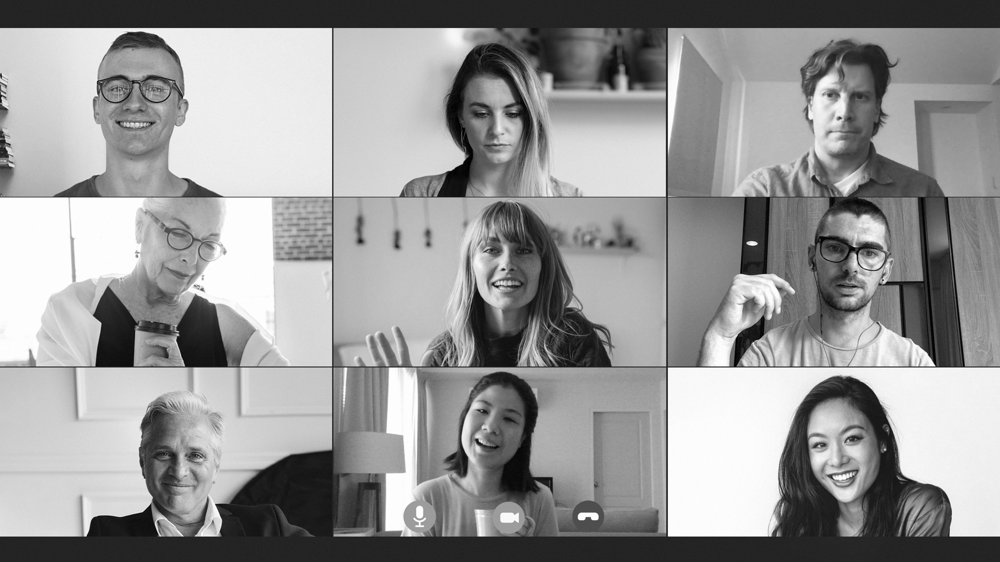

In [ ]:
# Transformando a imagem original em escala de cinza
original = imagem.copy()
gray = cv2.cvtColor(original, cv2.COLOR_BGR2GRAY)
cv2_imshow(gray)

In [ ]:
# Utilize o arquivo haarcascade de reconhecimento facial para detectar as faces na imagem
face_cascade = cv2.CascadeClassifier('/content/haarcascade_frontalface_default.xml')
faces = face_cascade.detectMultiScale(gray, 1.1, 3)

1/1 [==============================] - 0s 16ms/step


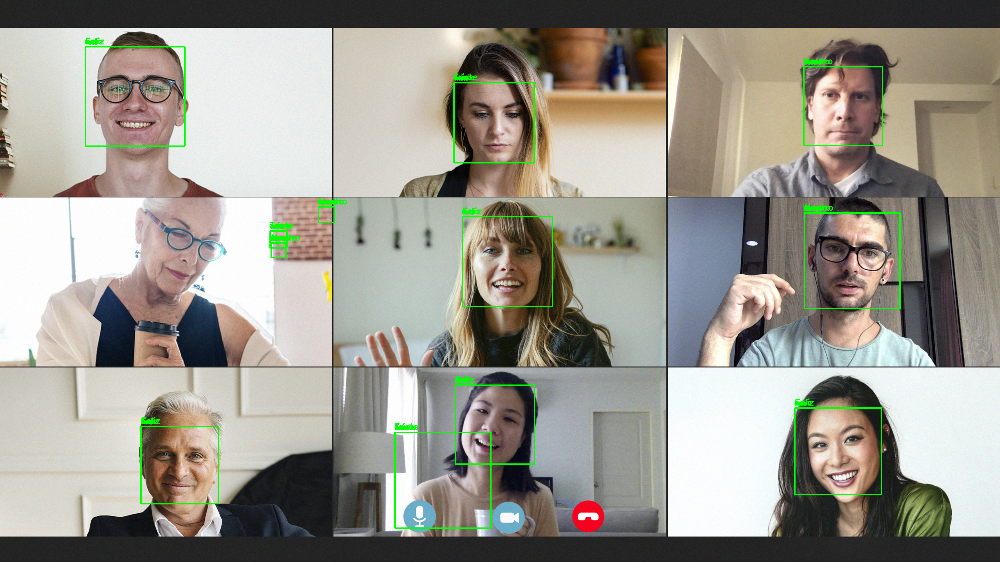

In [ ]:
# Reconhecendo as emoções nas faces detectadas, criando um retângulo e indicação textual na imagem original.
for (x, y, w, h) in faces:
  cv2.rectangle(original, (x, y), (x + w, y + h), (0, 255, 0), 4)
  roi_gray = gray[y:y + h, x:x + w]
  roi_gray = roi_gray.astype('float') / 255.0
  cropped_img = np.expand_dims(np.expand_dims(cv2.resize(roi_gray, (48, 48)), -1), 0)
  prediction = loaded_model.predict(cropped_img)[0]
  cv2.putText(original, expressoes[int(np.argmax(prediction))], (x, y - 10),
              cv2.FONT_HERSHEY_SIMPLEX, 0.6, (0, 255, 0), 2, cv2.LINE_AA)

cv2_imshow(original)